# The Effectiveness of Edge Detection Evaluation Metrics for Automated Coastline Detection

Origin Author: Conor O'Sullivan, 27 Feb 2023

> Necessary modifications were made for the need, and do not affect the operation of the code as well as the effect. —— Hivan Du

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random

import cv2
import glob
from skimage import feature

from skimage.metrics import structural_similarity as ssim
from sewar.full_ref import rmse, psnr, uqi

# Import helper functions from utils.py
import utils 
import os
dp = os.environ.get('pub_data')

In [ ]:
# Save path 
save_path = dp + 'Evaluation_metrics/'

# Global variables
channels = ['Coastal \nAerosol','Blue','Green',
                 'Red','Red Edge 1','Red Edge 2',
                'Red Edge 3','NIR','Red Edge 4',
                 'Water \nVapour','SWIR 1','SWIR 2']

thresholds = [[50,100],[50,150],[100,200],[100,300],[200,400],[200,600]] 

In [3]:
# Reload utils
import importlib
importlib.reload(utils)

<module 'utils' from '/Volumes/Library/git/hivan/public_articles/src/edge-detection-metrics/utils.py'>

## Load images and edge reference

In [4]:
test_path = glob.glob(dp + "SWED/test/images/*")
print(test_path[0])
print(len(test_path))

# Initialise data processing class
processor = utils.data_processor()

def get_input(paths):
    # Load all images and labels
    input = []
    rgb = []
    labels = []

    for path in paths:
        try:
            img, rgb_img, label = processor.load_test(path)
        
            input.append(img)
            labels.append(label)
            rgb.append(rgb_img)
        except:
            print("Error with image: ", path)

    # Apply canny edge detection to binary maps to get reference edges
    canny_input = [np.uint8(img*255) for img in labels]
    edge_reference = [np.uint8(cv2.Canny(img,threshold1 = 100, threshold2 = 200)) for img in canny_input]

    return input, rgb, labels, edge_reference

input, rgb, labels, edge_reference = get_input(test_path)


/Volumes/Library/SynologyDrive/data/public_articles/SWED/test/images/S2A_MSIL2A_20191105T023901_N0213_R089_T50RPN_20191105T062756_image_0_0.tif
98


/Users/du/miniforge3/envs/ml/lib/python3.9/site-packages/osgeo/gdal.py:311: FutureWarning: Neither gdal.UseExceptions() nor gdal.DontUseExceptions() has been explicitly called. In GDAL 4.0, exceptions will be enabled by default.
  warnings.warn(


80
0 255


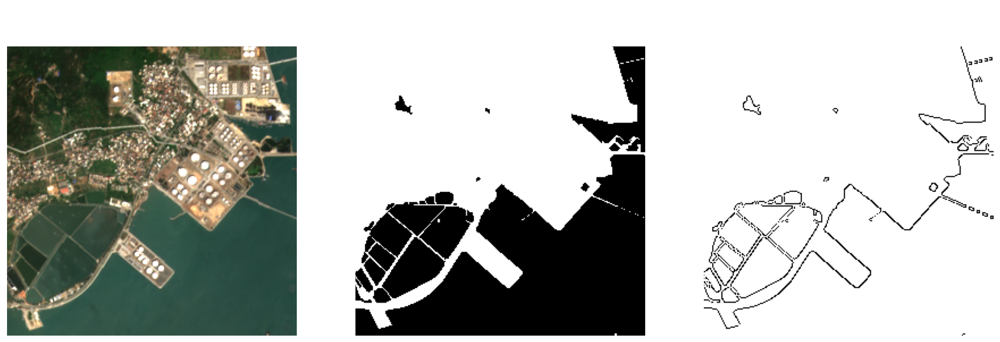

In [5]:
# Sense check edge references
rint = np.random.randint(0,len(edge_reference))
print(rint)
fig, ax = plt.subplots(1,3, figsize=(20,20))
fig.set_facecolor('white')

ax[0].imshow(rgb[rint])
ax[0].set_title('RGB image',size=20)
ax[1].imshow(1-labels[rint] ,  cmap='gray')
ax[1].set_title('Ground Truth \nMask',size=20)
ax[2].imshow(255-edge_reference[rint], cmap='gray')
ax[2].set_title('Ground Truth \nEdge Map',size=20)

for a in ax:
    a.set_xticks([])
    a.set_yticks([])

print(np.min(edge_reference[rint]) ,np.max(edge_reference[rint]))

plt.savefig(save_path + 'Figures/dataset_example.png', dpi=300, bbox_inches='tight')

## Apply canny edge detection and evaluation metrics

In [6]:
# Apply canny edge detection with different intensity thresholds
def get_canny(input):
        canny_input = input.copy()
        canny = {}

        for threshold in thresholds:
                t1 = threshold[0]
                t2 = threshold[1]
                canny[str(threshold)] = [processor.canny_ed(img,threshold1=t1,threshold2=t2) for img in canny_input]

                print(threshold, len(canny[str(threshold)]),'done')

        return canny

canny = get_canny(input)

[50, 100] 98 done
[50, 150] 98 done
[100, 200] 98 done
[100, 300] 98 done
[200, 400] 98 done
[200, 600] 98 done


In [7]:
# Evaluate canny edge detection with rmse, psnr, uqi, ssim and fom and confusion matrix measures
rows = []

for threshold in thresholds:
    canny_output = canny[str(threshold)]

    for i, output in enumerate(canny_output):
        ref_img = edge_reference[i]
        ID = "IMG#{}".format(i)

        for j in range(len(channels)):
                
            img = output[:,:,j]

            # Evaluation metrics
            rmse_ = rmse(ref_img,img)
            psnr_ = psnr(ref_img,img)
            uqi_ = uqi(ref_img,img)
            ssim_ = ssim(ref_img,img,multichannel=True)
            fom_ = processor.fom(ref_img,img)
            tp_,fp_,tn_,fn_,tpr_,fpr_,tnr_,fnr_,fp_fn_ratio_ = processor.get_rates(ref_img,img)

            # detect edges as a percentage of reference edges
            pde_ = np.count_nonzero(img)/np.count_nonzero(ref_img)
            
            row = [ID,str(threshold),j+ 1,rmse_,psnr_,uqi_,ssim_,fom_,tp_,fp_,tn_,fn_,tpr_,fpr_,tnr_,fnr_,fp_fn_ratio_,pde_]
            rows.append(row)

    print(threshold,'done')
    
df_metrics = pd.DataFrame(rows,columns = ['ID',"thresholds","band","rmse","psnr","uqi","ssim","fom","tp","fp","tn","fn","tpr","fpr","tnr","fnr","fp_fn_ratio","pde"])
df_metrics.to_csv(save_path+"canny_evaluation_metrics.csv")
df_metrics.head()

/var/folders/h4/7cr1cmpn7v5b3x20_9wz8m740000gn/T/ipykernel_38663/4099152901.py:19: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_ = ssim(ref_img,img,multichannel=True)


[50, 100] done
[50, 150] done
[100, 200] done
[100, 300] done
[200, 400] done
[200, 600] done


,ID,thresholds,band,rmse,psnr,uqi,ssim,fom,tp,fp,tn,fn,tpr,fpr,tnr,fnr,fp_fn_ratio,pde
0,IMG#0,"[50, 100]",1,82.603743,9.790809,0.399616,0.587947,0.199321,181,5197,58478,1680,0.097260,0.081618,0.918382,0.902740,3.093452,2.889844
1,IMG#0,"[50, 100]",2,99.235137,8.197494,0.376802,0.522827,0.171326,293,8357,55318,1568,0.157442,0.131245,0.868755,0.842558,5.329719,4.648039
2,IMG#0,"[50, 100]",3,100.822206,8.059680,0.374659,0.513517,0.174718,311,8695,54980,1550,0.167114,0.136553,0.863447,0.832886,5.609677,4.839334
3,IMG#0,"[50, 100]",4,105.510734,7.664871,0.367451,0.481393,0.196217,543,9902,53773,1318,0.291779,0.155508,0.844492,0.708221,7.512898,5.612574
4,IMG#0,"[50, 100]",5,90.458256,9.001839,0.384508,0.557746,0.229358,481,6867,56808,1380,0.258463,0.107845,0.892155,0.741537,4.976087,3.948415


## Analyse metric trend

In [15]:
df_metrics = pd.read_csv(save_path+"canny_evaluation_metrics.csv",index_col=0)
df_metrics['fp_fn'] = df_metrics['fp'] + df_metrics['fn']

# Initialise visualisation class
viz = utils.data_visualizer(df_metrics,canny,edge_reference,rgb,thresholds,channels)

In [16]:
df_metrics.head()

,ID,thresholds,band,rmse,psnr,uqi,ssim,fom,tp,fp,tn,fn,tpr,fpr,tnr,fnr,fp_fn_ratio,pde,fp_fn
0,IMG#0,"[50, 100]",1,82.603743,9.790809,0.399616,0.587947,0.199321,181,5197,58478,1680,0.097260,0.081618,0.918382,0.902740,3.093452,2.889844,6877
1,IMG#0,"[50, 100]",2,99.235137,8.197494,0.376802,0.522827,0.171326,293,8357,55318,1568,0.157442,0.131245,0.868755,0.842558,5.329719,4.648039,9925
2,IMG#0,"[50, 100]",3,100.822206,8.059680,0.374659,0.513517,0.174718,311,8695,54980,1550,0.167114,0.136553,0.863447,0.832886,5.609677,4.839334,10245
3,IMG#0,"[50, 100]",4,105.510734,7.664871,0.367451,0.481393,0.196217,543,9902,53773,1318,0.291779,0.155508,0.844492,0.708221,7.512898,5.612574,11220
4,IMG#0,"[50, 100]",5,90.458256,9.001839,0.384508,0.557746,0.229358,481,6867,56808,1380,0.258463,0.107845,0.892155,0.741537,4.976087,3.948415,8247


In [17]:
# Update visualisation class 
# The following test images are removed due to labelling errors: 18, 41, 66
df_metrics_2 = df_metrics.copy()
df_metrics_2 = df_metrics_2.drop(df_metrics_2[df_metrics_2['ID'] == 'IMG#18'].index)
df_metrics_2 = df_metrics_2.drop(df_metrics_2[df_metrics_2['ID'] == 'IMG#41'].index)
df_metrics_2 = df_metrics_2.drop(df_metrics_2[df_metrics_2['ID'] == 'IMG#66'].index)

test_paths_2 = test_path.copy()

path1 = test_paths_2.pop(18)
path2 = test_paths_2.pop(41-1)
path3 = test_paths_2.pop(66-2)

# print(path1)
# print(path2)
# print(path3)

input_2, rgb_2, labels_2, edge_reference_2 = get_input(test_paths_2)

canny_2 = get_canny(input_2)

viz_2 = utils.data_visualizer(df_metrics_2,canny_2,edge_reference_2,rgb_2,thresholds,channels)


[50, 100] 95 done
[50, 150] 95 done
[100, 200] 95 done
[100, 300] 95 done
[200, 400] 95 done
[200, 600] 95 done


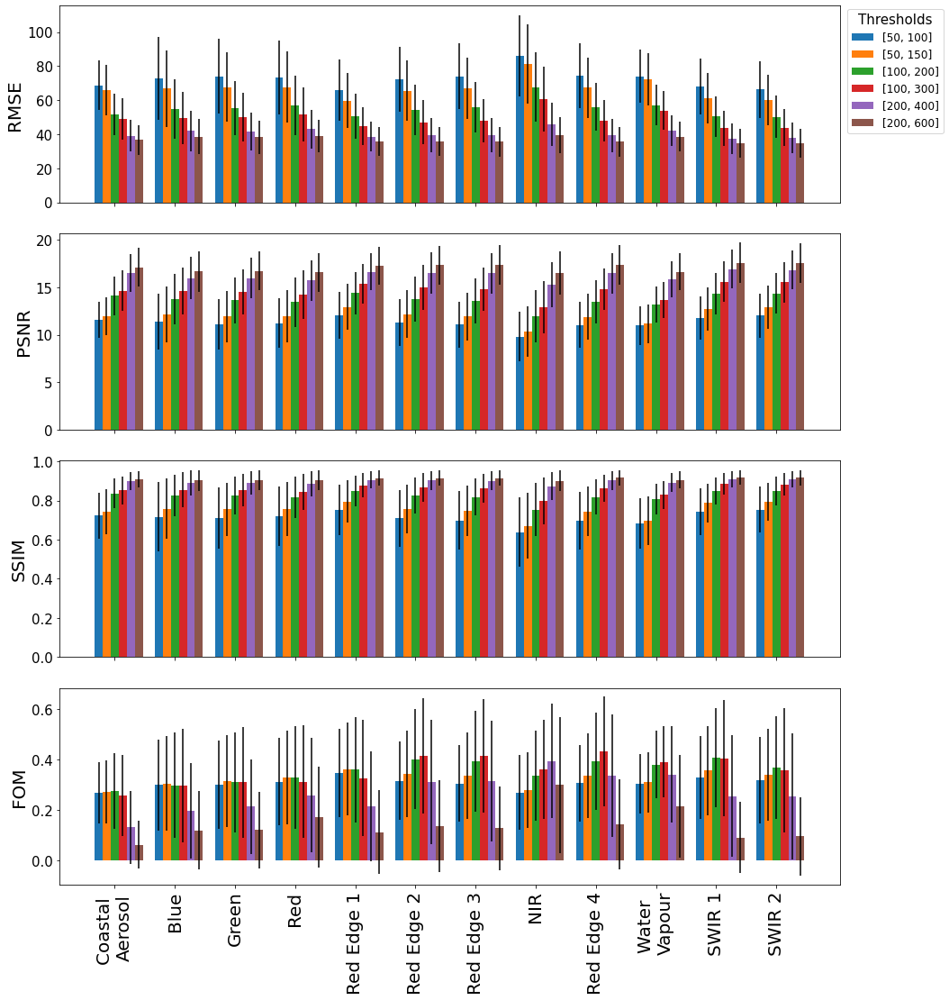

In [18]:
viz_2.plot_combined_metric_trends(['rmse','psnr','ssim','fom'],save_path=save_path+"Figures/all_metrics.png")

In [19]:
# NIR table 
df_metrics_nir = df_metrics_2[df_metrics_2['band']==7]

df_mean = df_metrics_nir[['thresholds', 'rmse','psnr','ssim','fom']].groupby('thresholds').mean().reset_index()
df_mean['threshold 1'] = df_mean['thresholds'].apply(lambda x: int(x.split(',')[0][1:]))
df_mean['threshold 2'] = df_mean['thresholds'].apply(lambda x: int(x.split(',')[1][:-1]))

df_mean = df_mean.sort_values(by=['threshold 1','threshold 2'])[['threshold 1','threshold 2','rmse','psnr','ssim','fom']]
df_mean.columns = ['Threshold 1','Threshold 2','RMSE','PSNR','SSIM','FOM']
df_mean = df_mean.round(2)

df_mean.to_clipboard(index=False)

df_mean.head()

,Threshold 1,Threshold 2,RMSE,PSNR,SSIM,FOM
4,50,100,73.92,11.07,0.70,0.31
5,50,150,67.04,11.94,0.75,0.34
0,100,200,55.75,13.52,0.82,0.39
1,100,300,47.96,14.81,0.86,0.41
2,200,400,39.47,16.47,0.90,0.32


In [23]:
# counts of best thresholds
best_threshold_count = pd.DataFrame(thresholds,columns=['threshold1','threshold2'])

for metric in ['rmse','psnr','ssim','fom']:

    df = df_metrics_2[['ID','thresholds',metric]]

    if metric == 'rmse':
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmin()]
    else:
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmax()]

    count = []
    for threshold in thresholds:
        df = best_thresholds[best_thresholds['thresholds']==str(threshold)]
        count.append(len(df))

    best_threshold_count[metric] = count

best_threshold_count.columns = ['Threshold 1','Threshold 2','RMSE','PSNR','SSIM','FOM']

best_threshold_count.to_clipboard(index=False)
best_threshold_count

,Threshold 1,Threshold 2,RMSE,PSNR,SSIM,FOM
0,50,100,0,0,0,2
1,50,150,0,0,0,7
2,100,200,2,2,2,12
3,100,300,1,1,3,30
4,200,400,4,4,20,29
5,200,600,88,88,70,15


## Visual analysis of best thresholds

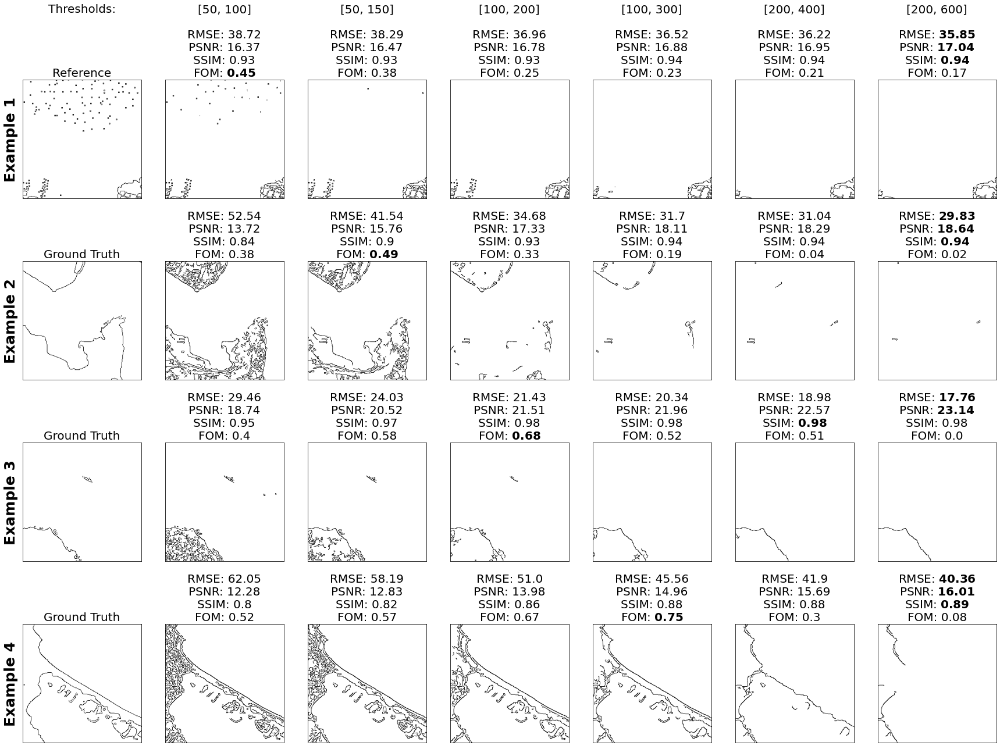

In [8]:
# Examples of results where FOM identifies the best threshold
IDs = [74,40,2,68]
viz.example_plots(IDs,save_path=save_path+"Figures/good_examples.png")

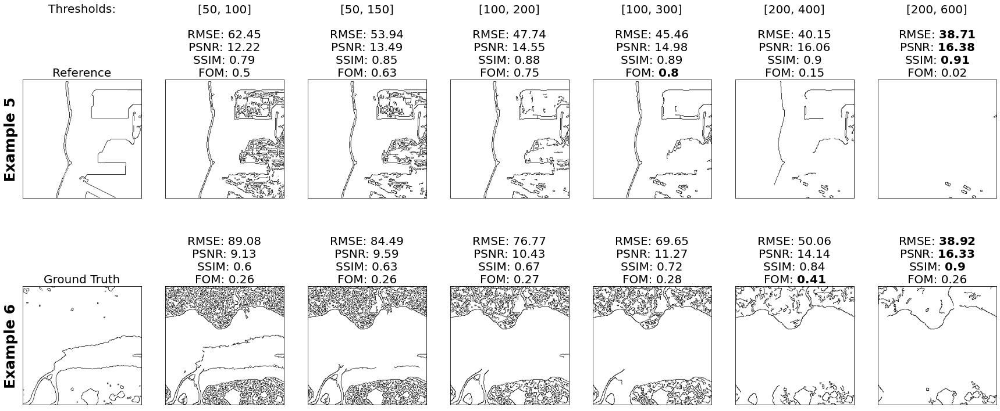

In [15]:
# Examples of results where FOM does not identify the best threshold
IDs = [15,32]
viz.example_plots(IDs,ex_diff=4,save_path=save_path+"Figures/bad_examples.png")

## Reason for metric failure 

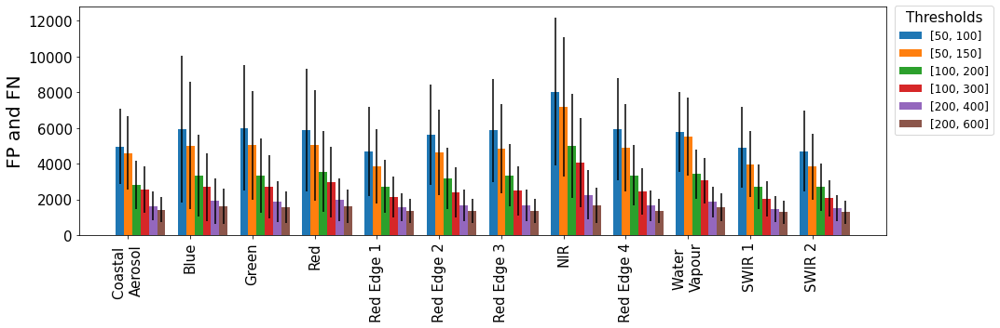

In [22]:
# Sum FP and FN for each threshold
viz_2.plot_metric_trends('fp_fn',ylabel="FP and FN", save_path = save_path+"Figures/fp_fn_sum.png")

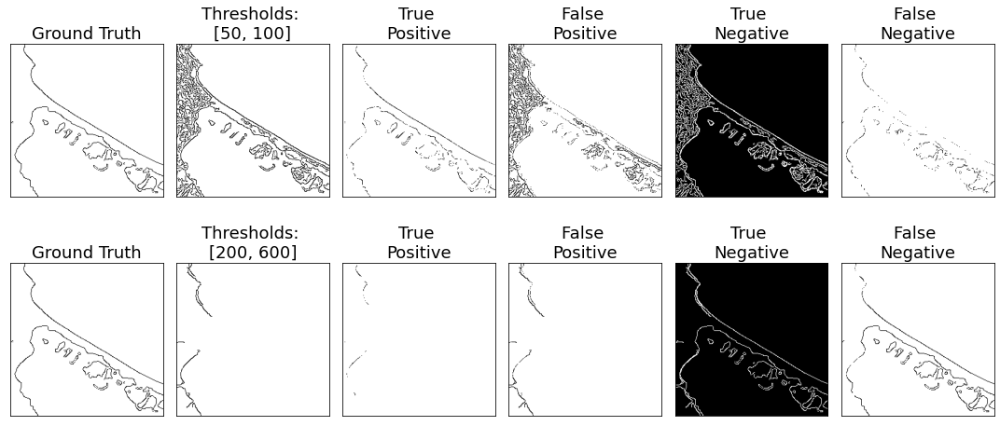

In [21]:
# Plot of confusion matrix metrics for different thresholds
rint = random.randint(0,len(edge_reference))
rint = 68 
band = 7 
threshold = [100,300]

fig, axs = plt.subplots(2,6, figsize=(15,7))
fig.set_facecolor('white')

for i, threshold in enumerate([[50,100],[200,600]]):
    reference = edge_reference[rint]*1.0
    reference = np.array(reference)

    detected =  canny[str(threshold)][rint][:,:,band]*1.0
    detected = np.array(detected)

    # True Positive
    TP = reference - (255-detected)
    TP[TP<0] = 0

    # False Positive
    FP = detected - TP

    # False negatives
    N = 255 - detected
    FN = N - (255-reference)

    # True Negative
    TN  = (255-reference) -detected
    TN[TN<0] = 0

    # False Negative
    FN = (255-detected) - (255-reference)
    FN[FN<0] = 0

    axs[i,0].imshow(255-reference,cmap="gray")
    axs[i,0].set_title("Ground Truth",size=18)

    axs[i,1].imshow(255-detected,cmap="gray")
    axs[i,1].set_title("Thresholds: \n{}".format(threshold),size=18)

    axs[i,2].imshow(255-TP,cmap="gray")
    axs[i,2].set_title("True \nPositive",size=18)

    axs[i,3].imshow(255-FP,cmap="gray")
    axs[i,3].set_title("False \nPositive",size=18)

    axs[i,4].imshow(255-TN,cmap="gray")
    axs[i,4].set_title("True \nNegative",size=18)

    axs[i,5].imshow(255-FN,cmap="gray")
    axs[i,5].set_title("False \nNegative",size=18)

for ax in axs.flat:
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.savefig(save_path+"Figures/TP_FP_example.png",dpi=300)

# Figure for abstract

In [ ]:
fig, axs = plt.subplots(1, 5, figsize=(30, 20))
fig.set_facecolor('white')
#rint = np.random.randint(0, len(input))
rint = 67

thresholds = [[50,100],[100,200],[200,400]]

band = 10 

img_input = input[rint].copy()
#img_input = preprocess(img_input,[False,False,False])

axs[0].imshow(img_input[:,:,band],cmap="gray")
axs[0].set_title("Input Image",size=25)

ref_img = edge_reference[rint]
axs[1].imshow(255-ref_img,cmap="gray")
axs[1].set_title("Edge \nReference",size=25)

for ax in axs:
    ax.set_xticks([])
    ax.set_yticks([])

for i,threshold in enumerate(thresholds):
        
    t1 = threshold[0]
    t2 = threshold[1]
    canny = utils.canny_ed(img_input,threshold1=t1,threshold2=t2)
    img = canny[:,:,band]
    
    axs[i+2].imshow(255-img,cmap="gray")
    rmse_ = round(rmse(ref_img,img),2)
    psnr_ = round(psnr(ref_img,img),2)
    ssim_ = round(ssim(ref_img,img,multichannel=True),2)
    fom_ = round(utils.fom(ref_img,img),2)

    if i == 0:
        axs[i+2].set_title("\nRMSE: {}\nPSNR: {}\nSSIM: {}\nFOM: {}".format(rmse_,psnr_,ssim_,fom_),size=20)
    elif i == 1:
        axs[i+2].set_title("\nRMSE: {}\nPSNR: {}\nSSIM: {}\nFOM: ".format(rmse_,psnr_,ssim_)+ r"$\bf{" + str(fom_) + "}$",size=20)
    else:
        axs[i+2].set_title("\nRMSE: " + r"$\bf{" + str(rmse_) + "}$" + 
        "\nPSNR: " + r"$\bf{" + str(psnr_) + "}$" +
        "\nSSIM: " + r"$\bf{" + str(ssim_) + "}$" +
        "\nFOM: " +str(fom_),size=20)

    #plt.savefig(fig_path.format("abstract.png"),bbox_inches="tight")    

# Visual analysis

In [81]:
#Get image names for visual analysis
x = [path.split("/")[-1] for path in test_path]
df = pd.DataFrame({"ID":x})
df.to_clipboard(index=False)

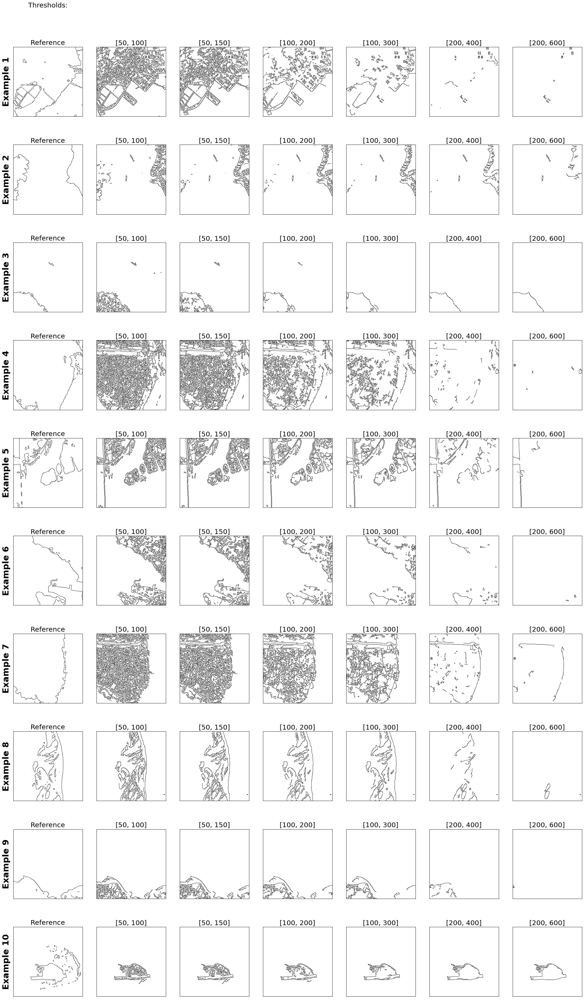

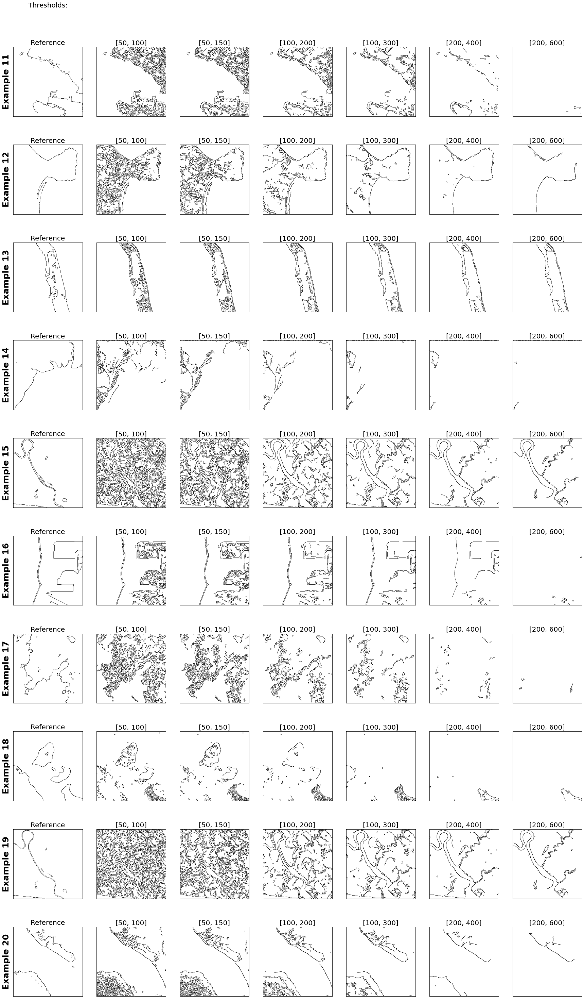

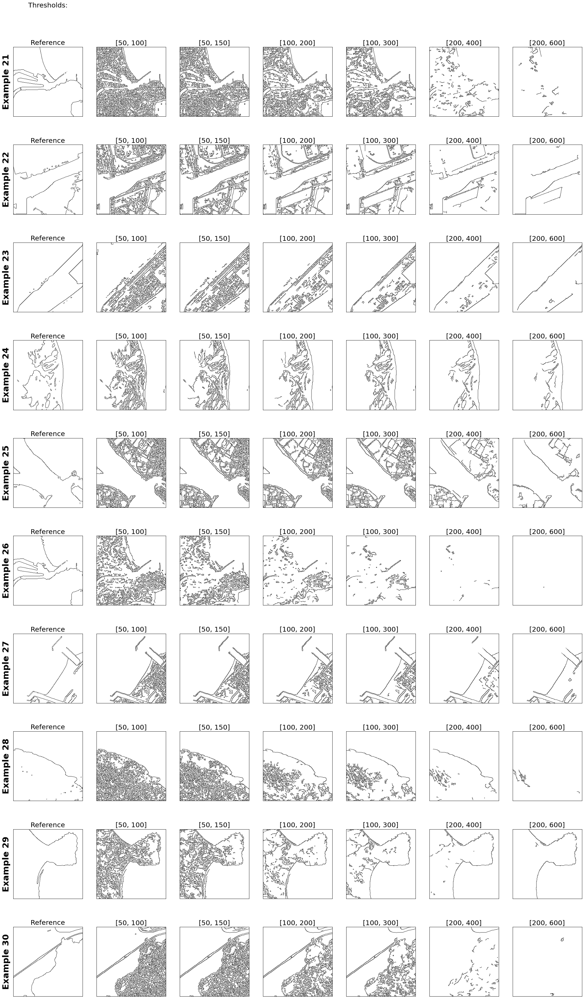

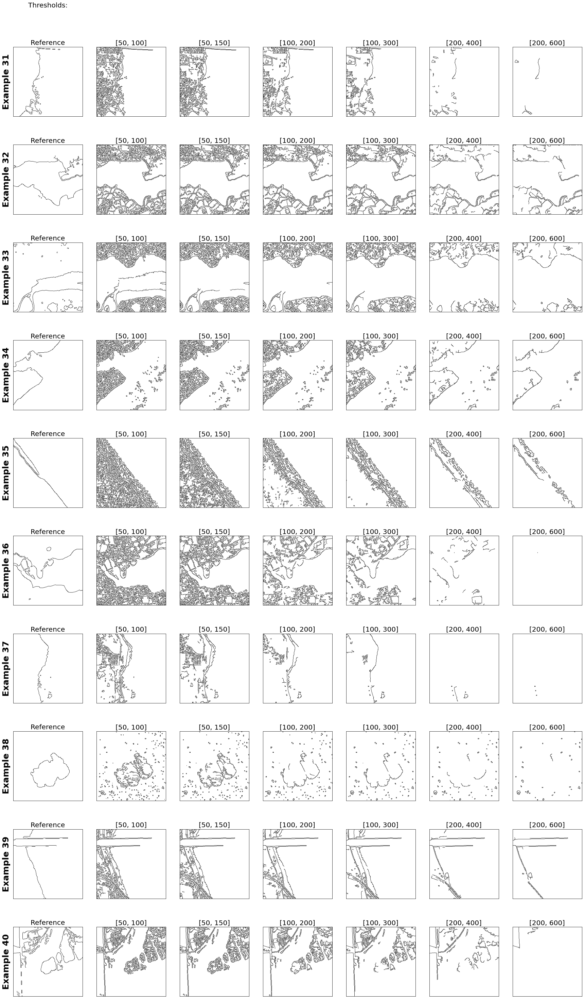

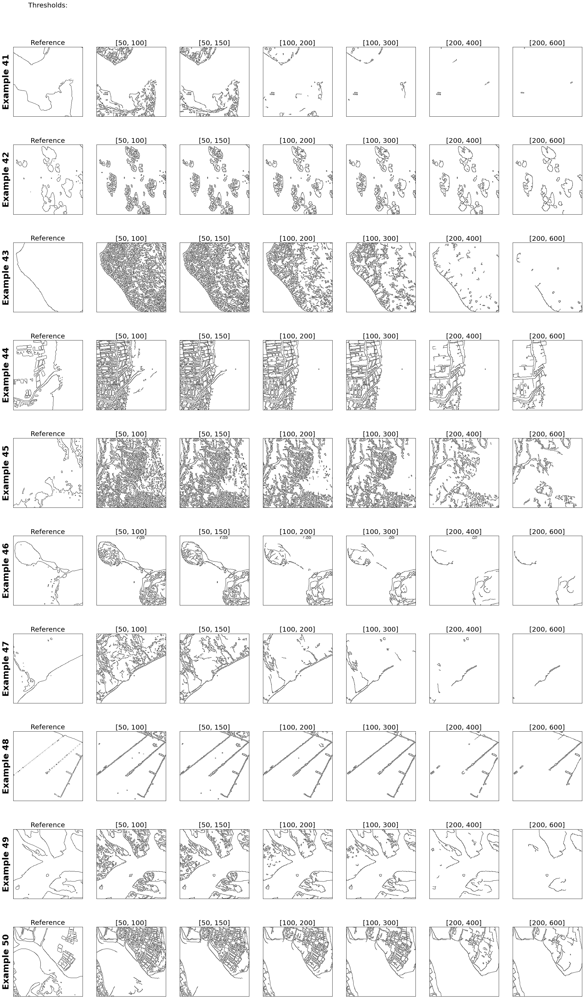

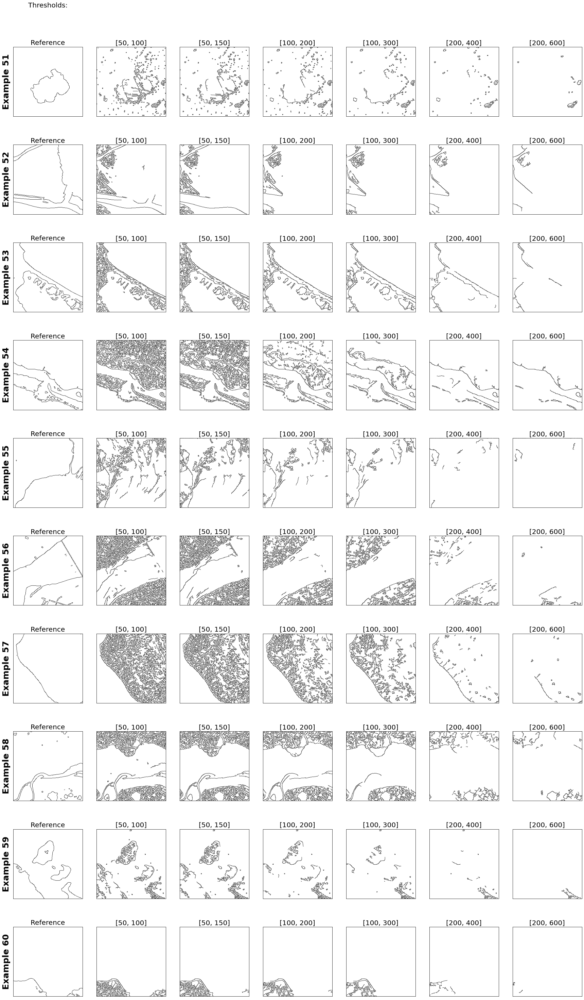

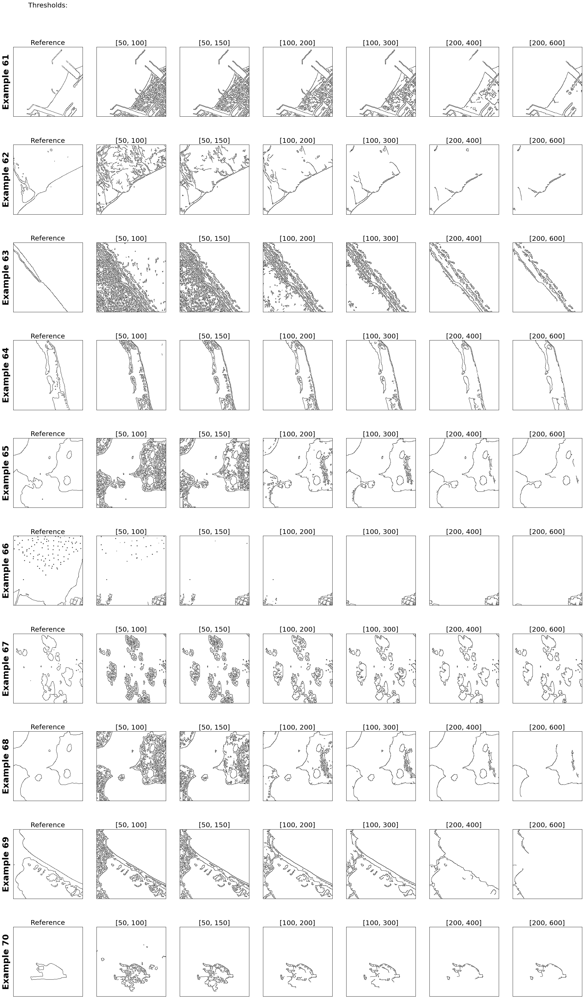

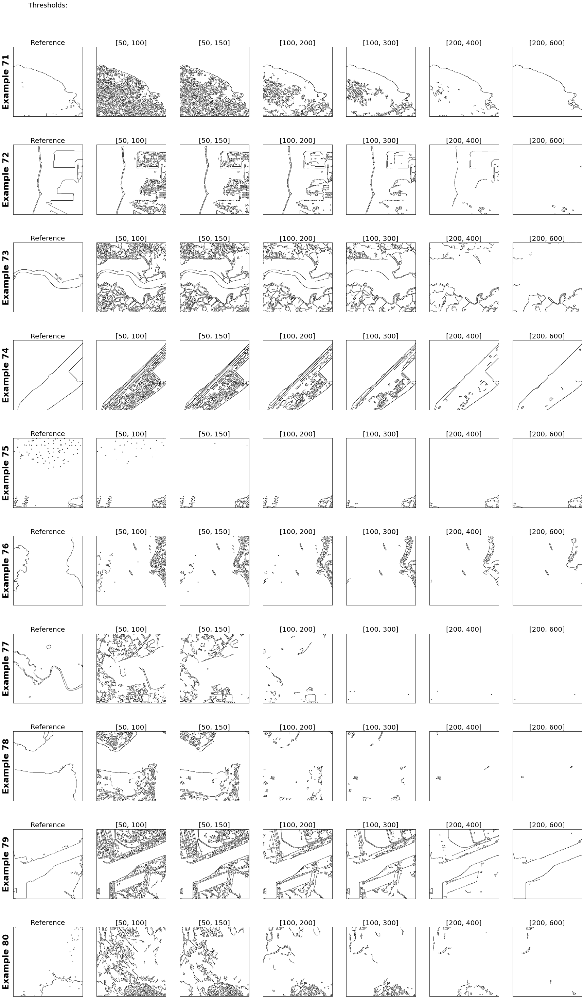

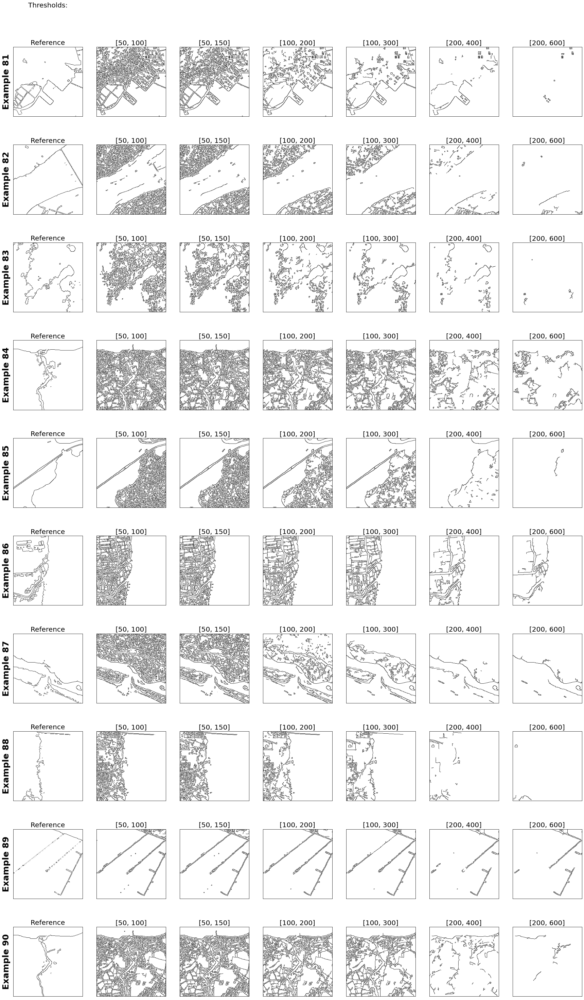

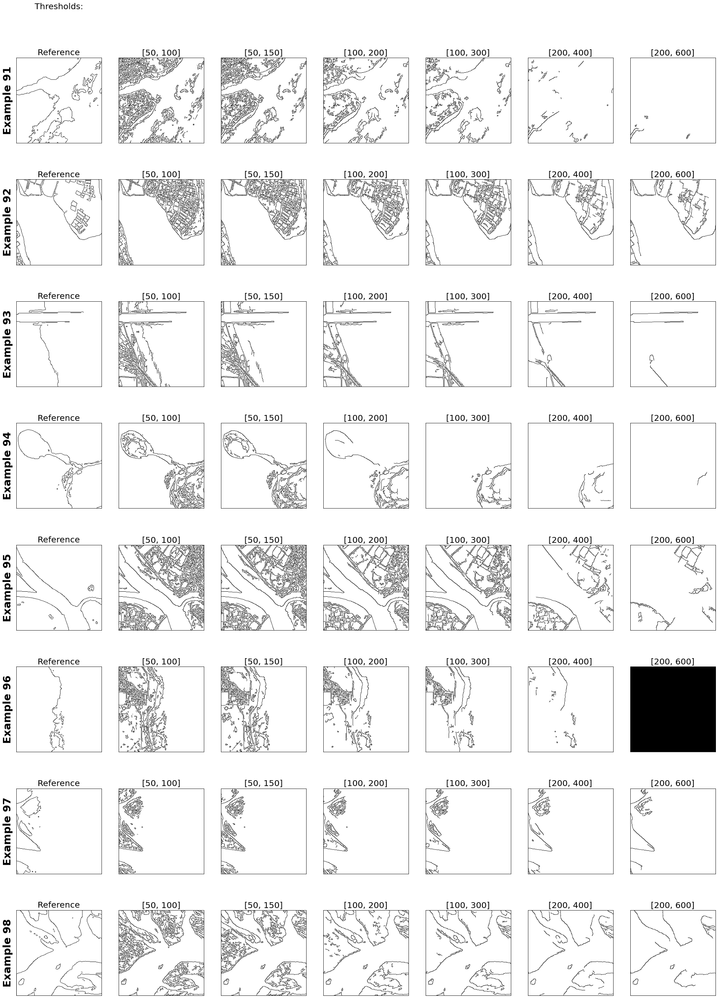

In [6]:
# Visual inspection to choose the best band
# Exclude images 18+1, 41+1, 66+1 from final analysis
ALL_IDS = [range(0,10),range(10,20),range(20,30),range(30,40),range(40,50),range(50,60),range(60,70),range(70,80),range(80,90),range(90,98)]

for i,IDs in enumerate(ALL_IDS):
    viz.example_plots(IDs,ex_diff=10*i,show_metrics=False)

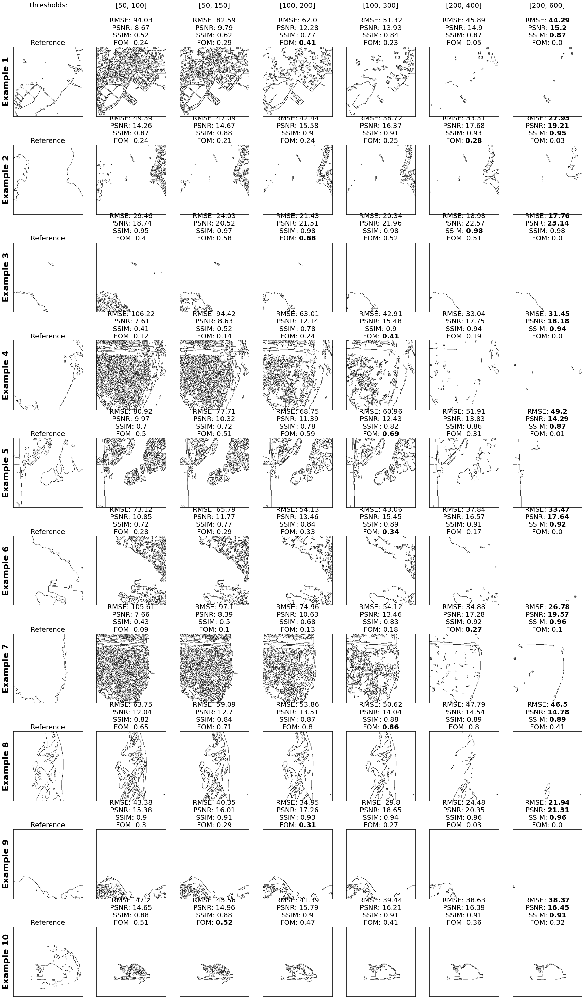

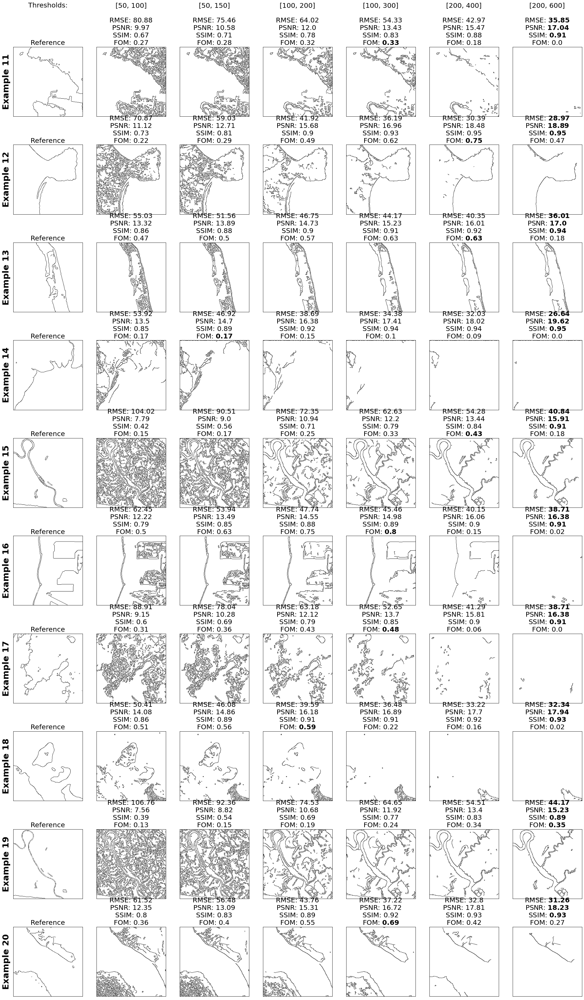

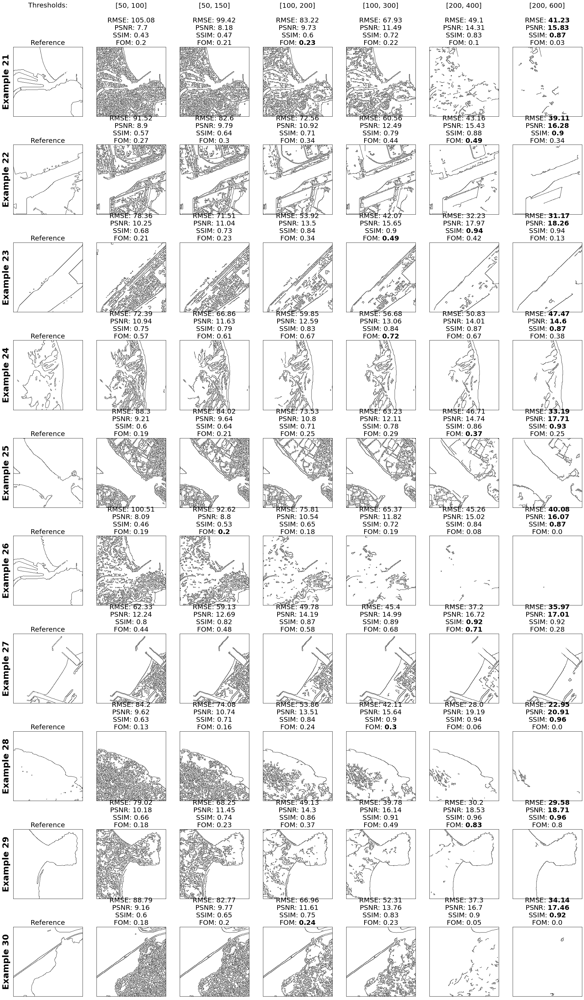

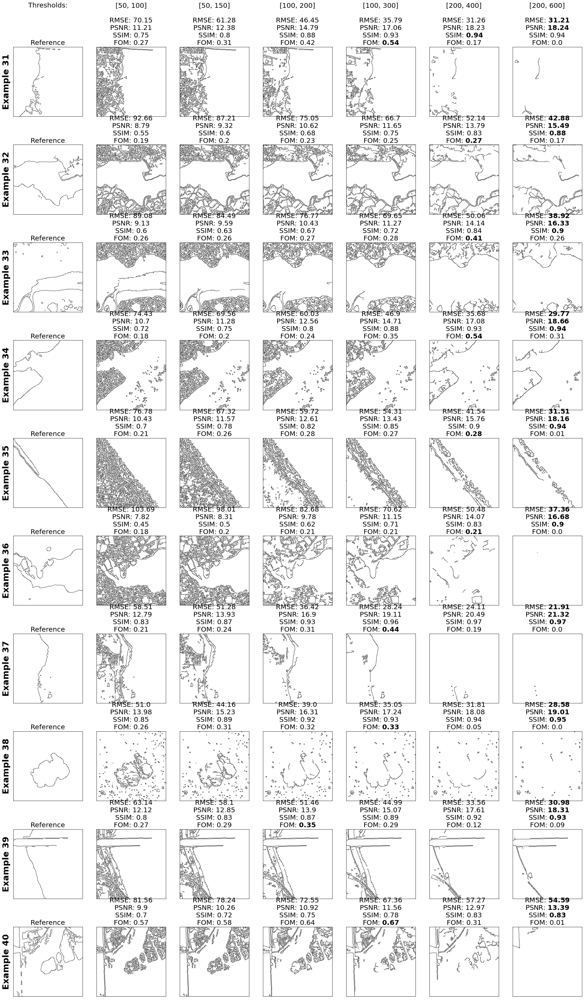

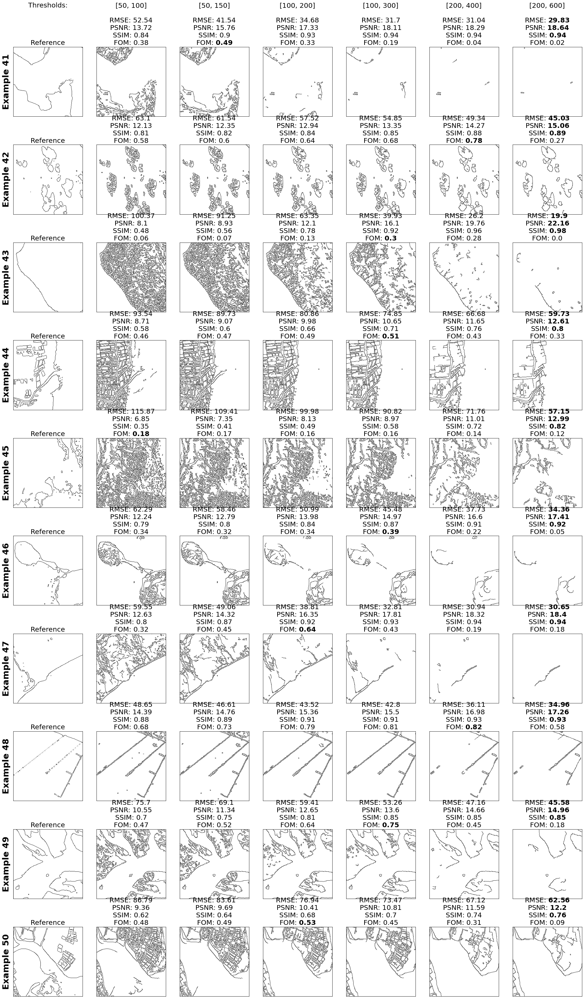

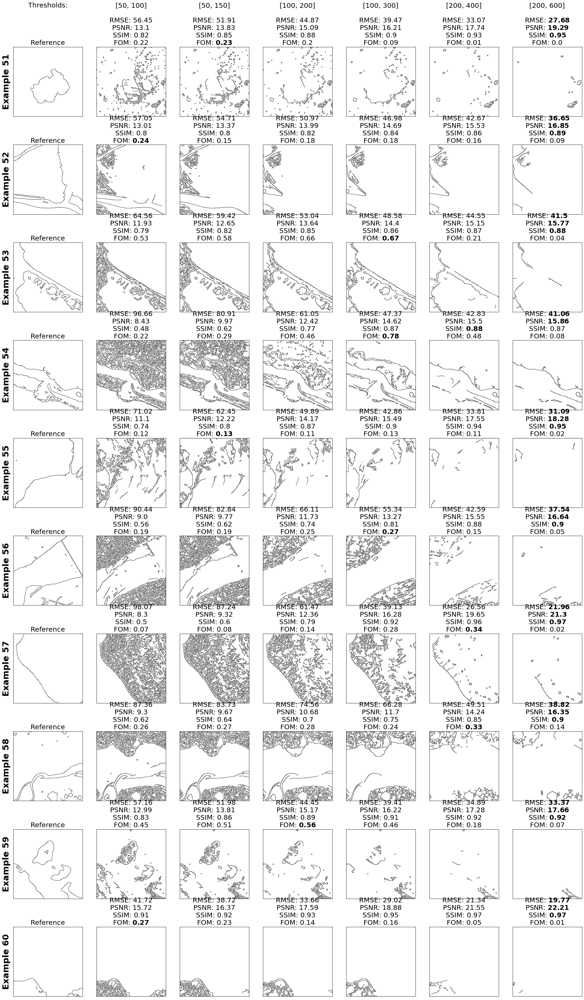

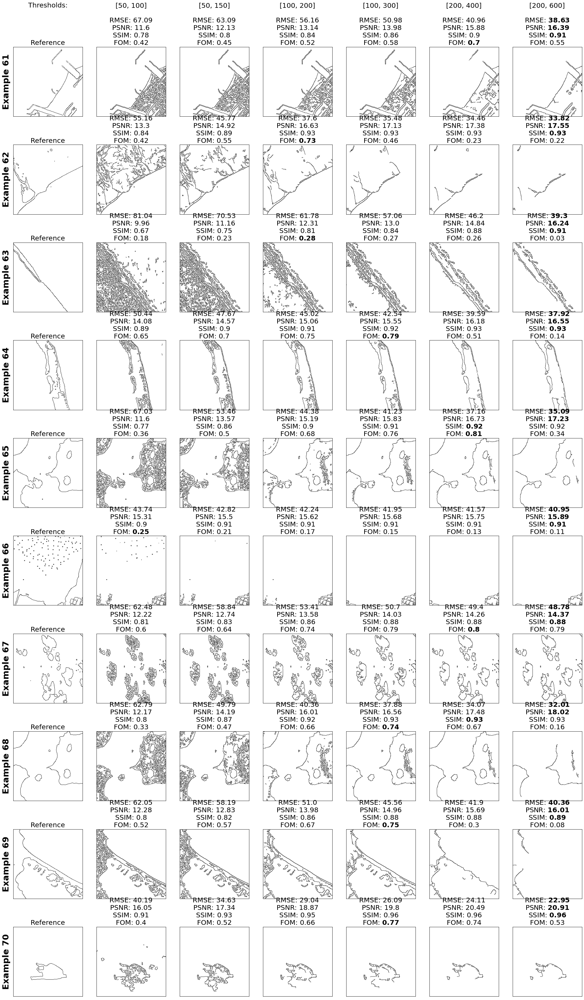

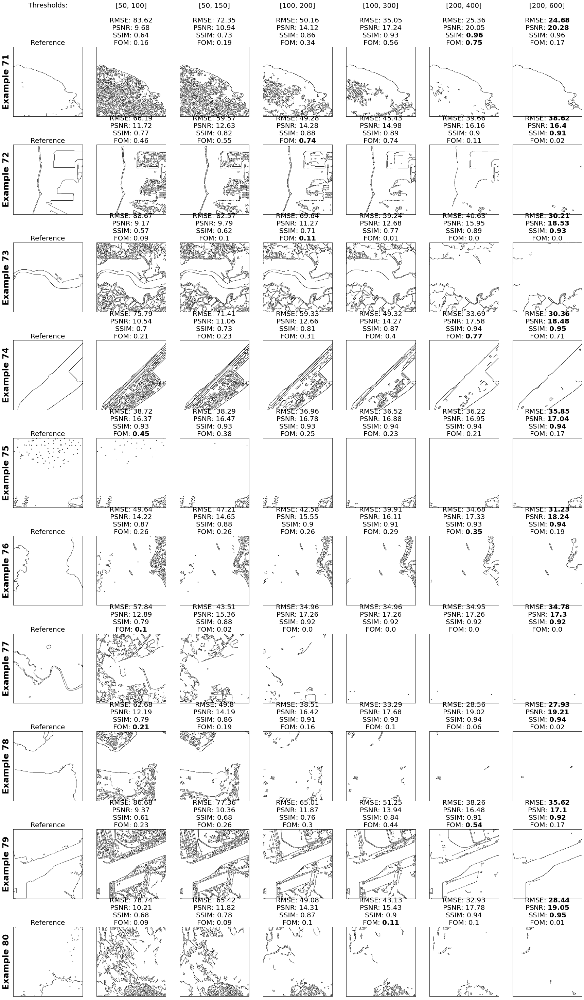

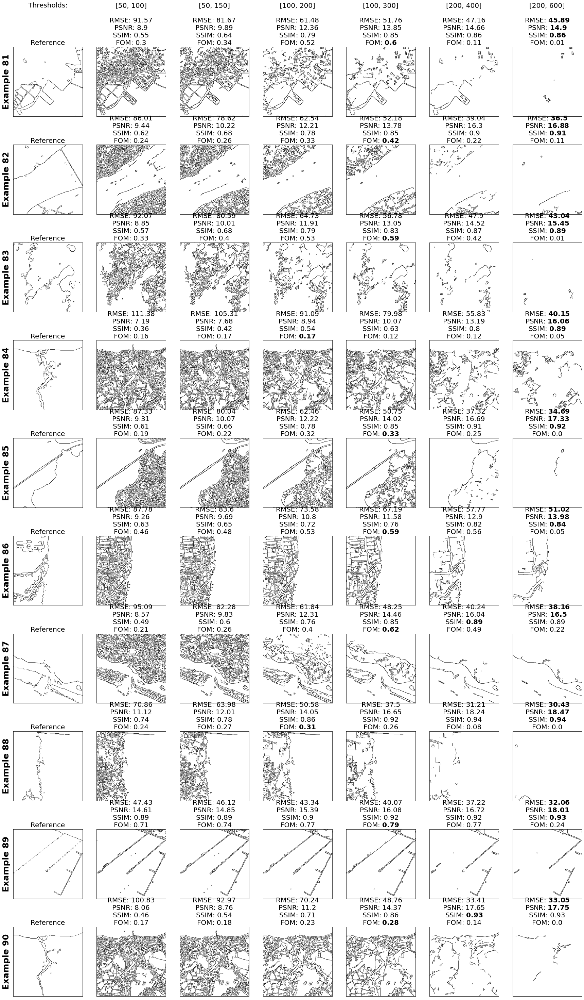

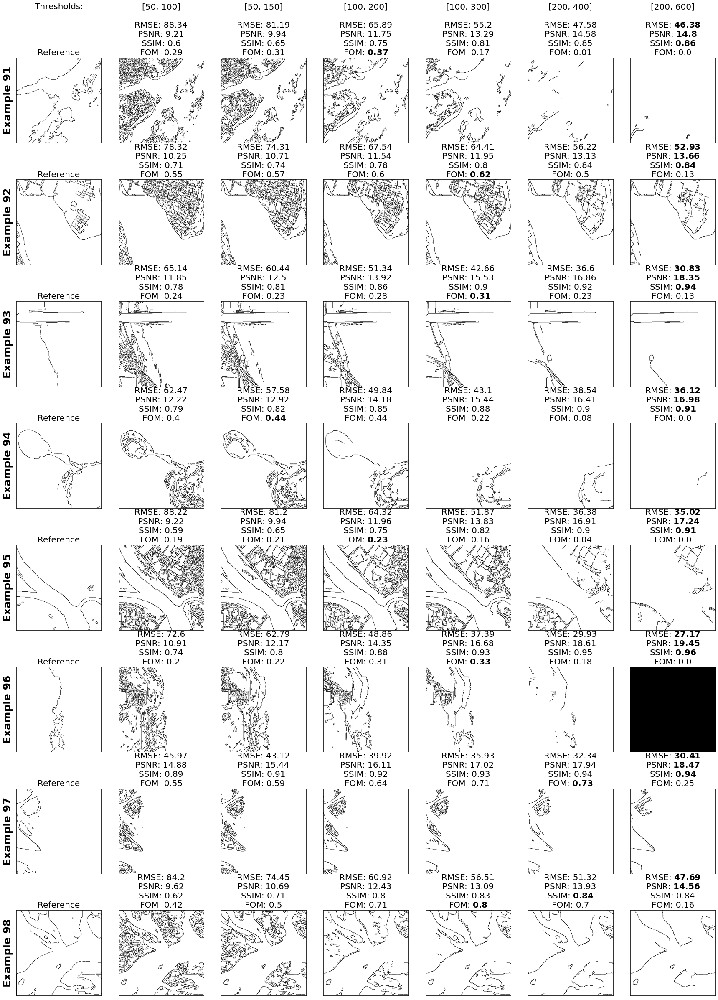

In [7]:
# Compare band to best metric
ALL_IDS = [range(0,10),range(10,20),range(20,30),range(30,40),range(40,50),range(50,60),range(60,70),range(70,80),range(80,90),range(90,98)]

for i,IDs in enumerate(ALL_IDS):
    viz.example_plots(IDs,ex_diff=10*i)